# Libraries

In [1]:
import numpy as np
import pandas as pd
import networkx as nx
import pickle as pkl

import os

os.chdir('Script/')
import GraphFilterSmootherModule
import EMModule
os.chdir('../')

os.chdir('Script/C_module/')
import GraphFilterSmoother_C
os.chdir('../../')

import colorsys

def pseudocolor(val):
    h = (1.0 - val) * 120 / 360
    r, g, b = colorsys.hsv_to_rgb(h, 1., 1.)
    return r * 255, g * 255, b * 255

import matplotlib.pyplot as plt

plt.style.use('seaborn-whitegrid')

# London's tube graph

## Preliminaries

Load the unique correspondence between factors and stations.

In [2]:
pkl_file = open('Data/names_dictionary.pkl', 'rb')

names_dictionary = pkl.load(pkl_file)

Distinguis between stations and stations inflow-outflow

In [3]:
F = names_dictionary["F"]
Stations_full = names_dictionary["Stations_full"]
Stations = names_dictionary["Stations"]


# Training

Load the bipartite graph

C:\Users\loren\Anaconda3\lib\site-packages\networkx\drawing\nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


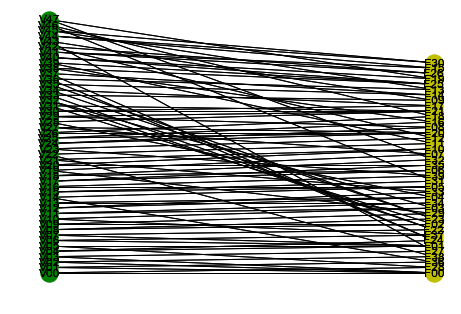

In [4]:
lanepartBipartite = nx.read_gpickle("Data/BipartiteLondon.gpickle")

# reognize the different nodes
top_nodes = []
bottom_nodes = []

for item, bipartite in lanepartBipartite.nodes(data=True):
#     print(bipartite)
    if bipartite['bipartite']==0:
        top_nodes.append(item)
    else:
        bottom_nodes.append(item)

pos = dict()
pos.update( (n, (1, i)) for i, n in enumerate((np.array(top_nodes, dtype = '<U8'))) ) # put nodes from X at x=1
pos.update( (n, (2, i)) for i, n in enumerate((np.array(bottom_nodes, dtype = '<U8'))) ) # put nodes from Y at x=2
nx.draw(lanepartBipartite, pos, nodelist= top_nodes, node_color='g',  with_labels = True)
nx.draw(lanepartBipartite, pos, nodelist= bottom_nodes, node_color='y',  with_labels = True)
plt.show()

Load the data

In [5]:
YT = pkl.load( open( "Data/YT_train.pkl", "rb" ) )

Set the parameters

In [64]:
# size of the hidden variable
nlayers = len({n for n, d in lanepartBipartite.nodes(data=True) if d["bipartite"] == 0})

# Partition choice
trivialpart = dict()

for i in range(0,nlayers):   
    zeros = ""
    for j in range(len(str(nlayers))-len(str(i))):
        zeros = zeros + "0"
    trivialpart[str(i)] = ["V"+zeros+str(i)]

# states
states = [-5/2, -1, 0, 1, 5/2]

# m 
m = 0

# initial distribution
mu0_per_element = np.array([0, 0, 1, 0, 0], dtype= float)

mu0_initial = {}
for v in top_nodes:
    mu0_initial[v] = mu0_per_element


# transition kernel
P_initial = np.array([[.2, .2, .2, .2, .2],
                      [.2, .2, .2, .2, .2],
                      [.2, .2, .2, .2, .2],
                      [.2, .2, .2, .2, .2],			
                      [.2, .2, .2, .2, .2]], dtype = float)

transP_initial = np.zeros((nlayers, len(states), len(states)), dtype = float)
transP_initial = {}
for v in top_nodes:
    transP_initial[v] = P_initial

# c
c_initial = {}
for f in bottom_nodes:
        c_initial[f] = 1

# sigma
sigma_initial = {}
for f in bottom_nodes:
    sigma_initial[f] = 4



Define a GraphFilterSmoother object and train. Here we are using a simple version of the code, but a faster implementation is also available in the C_module folder. The code will produce a .txt file to check the progress of the simulation and at the end an output file

In [ ]:
GFS1 = GraphFilterSmootherModule.GraphFilterSmoother(lanepartBipartite, states, m, trivialpart, mu0_initial, transP_initial, c_initial, sigma_initial)

################################################################################
# EM algorithm 
################################################################################
iterations = 3
EMModule.EMmulti_gaussian( GFS1, YT, iterations )


The above is just to show how th code works, in this tutorial we will reproduce the results from the paper by simply reporting the ained models.

# Test

Load the test data.

In [8]:
YT_test = np.load("Data/YT_test_weekends.npy")


Load the parameters of the trained model (we will focus on the largest state space).

In [9]:
parameters_variable = pkl.load( open( "Data/GraphFilterSmoother-InflowOutflow-VarParameters-015-lenStateSpace-3.pkl", "rb" ) )
parameters_variable_big = pkl.load( open( "Data/GraphFilterSmoother-InflowOutflow-VarParameters-015-lenStateSpace-4.pkl", "rb" ) )

Plot the parameters

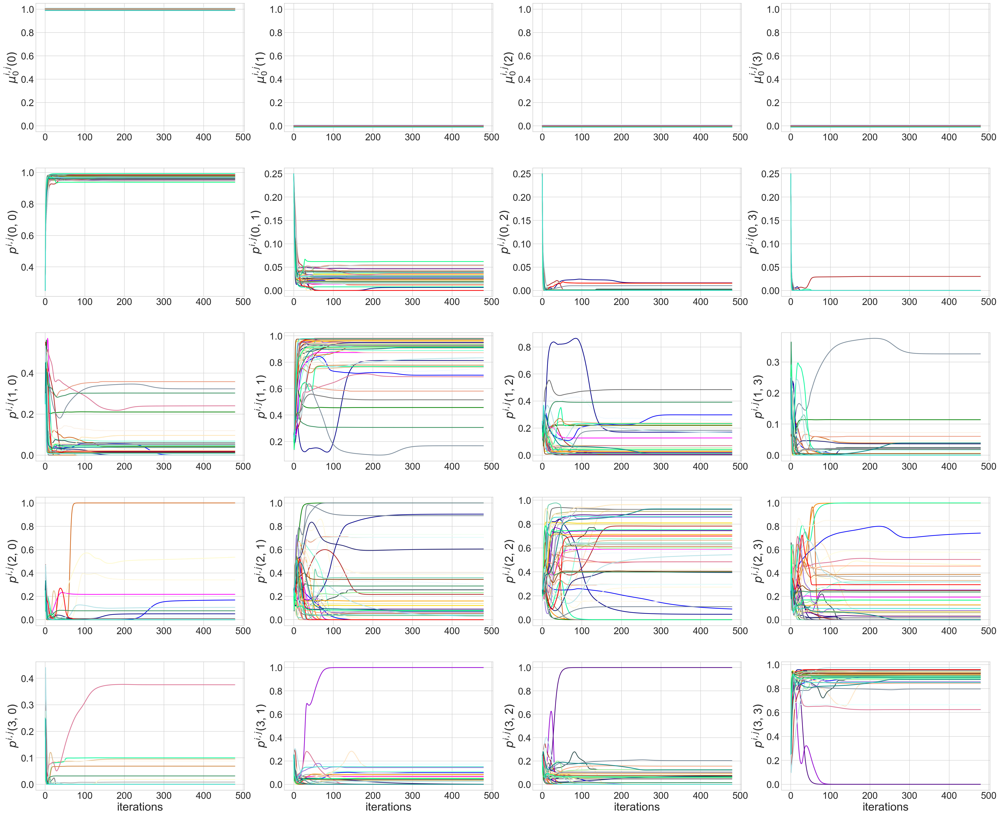

In [10]:
import matplotlib.colors as mcolors

color = list(mcolors.CSS4_COLORS.keys())

fig, ax = plt.subplots(num=None, figsize=(30, 25), dpi=200, facecolor='w', edgecolor='k',nrows=5, ncols=4)

fig.tight_layout(pad=6.0)

i=0
for j in range(0,4):
        for f in range(len(top_nodes)):
            mu = []
            ax[i,j].set_ylim((-0.05,1.05))
            if f< len(top_nodes)/2:
                c = 0.0005*f
            else:
                c = -0.0005*(f-len(top_nodes)/2+1)
            for t in range(0,480):
                mu.append(parameters_variable_big["mu_0_list"][t][f][j]+c)
            ax[i,j].plot(mu, color = color[3*f]) #color[kmeans.labels_[f]])#
#             ax[i,j].plot(mu, color = color[spectral.labels_[f]])#color[3*f])
#             ax[i,j].set_xlabel('iterations',fontsize=24)
            ax[i,j].set_ylabel(r'$\mu_0^{i,j}($'+str(j)+"$)$",fontsize=24)
            ax[i,j].tick_params(axis='x', labelsize=20) 
            ax[i,j].tick_params(axis='y', labelsize=20) 

for i in range(1, 5):
    for j in range(0,4):
        kernel_evolution = []
        for f in range(len(top_nodes)):
            kernel_evolution = []
            for t in range(0,480):
                kernel_evolution.append(parameters_variable_big["transP_list"][t][f][i-1,j])
            ax[i,j].plot(kernel_evolution, color = color[3*f]) #color[kmeans.labels_[f]])#
#             ax[i,j].plot(kernel_evolution, color = color[spectral.labels_[f]])#color[3*f])
            
            ax[i,j].set_ylabel(r'$p^{i,j}($'+str(i-1)+", "+str(j)+"$)$",fontsize=24)
            ax[i,j].tick_params(axis='x', labelsize=20) 
            ax[i,j].tick_params(axis='y', labelsize=20) 
            
            if i==4:
                ax[i,j].set_xlabel('iterations',fontsize=24)
            
            
# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Figures\london_kernel_em.eps', format='eps', dpi = 200)#, bbox_inches='tight')

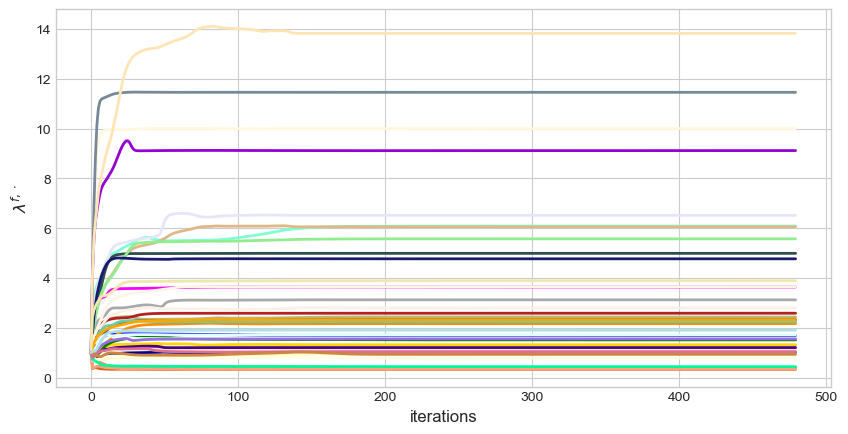

In [11]:
fig, ax = plt.subplots(num=None, figsize=(10, 5), dpi=100, facecolor='w', edgecolor='k',nrows=1, ncols=1)

lamb_evolution = []
for f in range(len(bottom_nodes)):
    lamb_evolution = []
    for t in range(0,480):
        lamb_evolution.append(parameters_variable_big["lamb_list"][t][f])
    ax.plot(lamb_evolution, color = color[3*f], linewidth = 2)
    
ax.set_xlabel('iterations',fontsize=12)
ax.set_ylabel(r'$\lambda^{f,\cdot}$',fontsize=12)

ax.tick_params(axis='x', labelsize=10) 
ax.tick_params(axis='y', labelsize=10)

# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Figures\london_lambda.eps', format='eps', dpi = 200, bbox_inches='tight')

## Prediction on the test data

Here we select the last iteration of the EM (our final parameters estimates) and run a new Graph Filter-Smoother to perform posterior predictive on all the stations.

In [12]:
# size of the hidden variable
nlayers = len({n for n, d in lanepartBipartite.nodes(data=True) if d["bipartite"] == 0})

# Partition choice
trivialpart = dict()

for i in range(0,nlayers):   
    zeros = ""
    for j in range(len(str(nlayers))-len(str(i))):
        zeros = zeros + "0"
    trivialpart[str(i)] = ["V"+zeros+str(i)]

# states
states = [0, 1, 2, 3]

# m 
m = 0

mu0_initial = []
for v in range(len(top_nodes)):

        mu0_initial.append(parameters_variable_big["mu_0_list"][400][v])

# transition kernel
transP_initial = []
for v in range(len(top_nodes)):
    
        transP_initial.append(parameters_variable_big["transP_list"][400][v])

# lambda
lamb_initial = []
for f in range(len(bottom_nodes)):

        lamb_initial.append(parameters_variable_big["lamb_list"][400][f])

# GraphFilterSmootherModule object
GFS2 = GraphFilterSmoother_C.GraphFilterSmoother_C(lanepartBipartite, states, m, trivialpart, mu0_initial, transP_initial, lamb_initial, )


In [13]:
GFS2.preprocessing()

In [14]:
import time

starting_time = 0
ending_time = 290

start = time.time()
pi_filt2 = GFS2.filtering( YT_test[starting_time:ending_time,:] )
end = time.time()
print(end - start)

146.04258251190186


In [15]:
y_post_pred = GFS2.posterior_predictive_sample(pi_filt2, 100)

Report all the stations

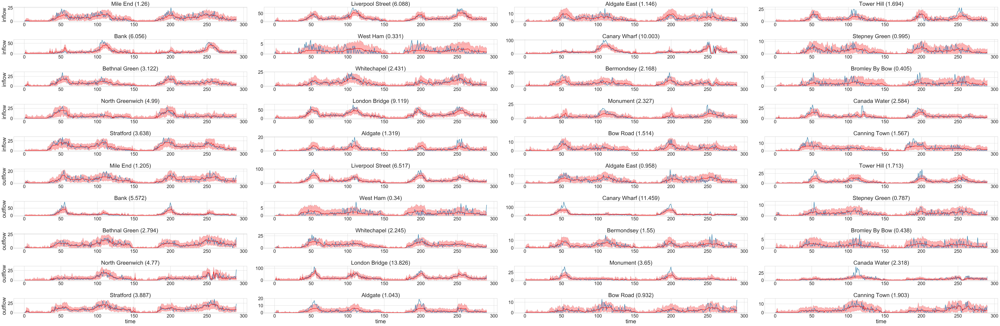

In [16]:
fig, ax = plt.subplots(num=None, figsize=(60, 20), dpi=200, facecolor='w', edgecolor='k',nrows=10, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(0, len(y_post_pred)+1, len(y_post_pred)+1)

i = 0
j = 0
color = "red"
for name in range(0, len(GFS2.factors)):
    
#     print(i, j)
#     if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

    #     if i == 5:
    #         i = 0
    #         color = "Black"
        if j==0:
            
            if i < 5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)

        if i == 9:
            ax[i,j].set_xlabel('time',fontsize=24)

    #     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),

        ax[i,j].plot(time, YT_test[starting_time:290,name])

        zeros = ""
        for k in range(len(str(len(GFS2.factors)))-len(str(name))):
            zeros = zeros + "0"    

        ax[i,j].set_title(Stations["F"+zeros+str(name)]+" "+ "("+str(round(GFS2.lamb[name], 3))+")", fontsize=24)
    #     ax[i,j].xaxis.set_tick_params(labelsize=12)

        sample    = np.array(y_post_pred)[:, name, :]
        quantiles = np.quantile(sample, (0.025, 0.5, 0.975), axis = 1)
        mean = np.mean(sample, axis = 1)

        ax[i,j].plot(time[1:], mean, color=color)   
        ax[i,j].fill_between(time[1:], quantiles[0,:], quantiles[2,:], alpha = 0.3, color=color ) 
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)

        j = j+1
fig.tight_layout(pad=3.0)
# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Appendix\london_GFSprediction_complete.pdf', format='pdf', dpi = 200, bbox_inches='tight')

Report a subset of the stations.

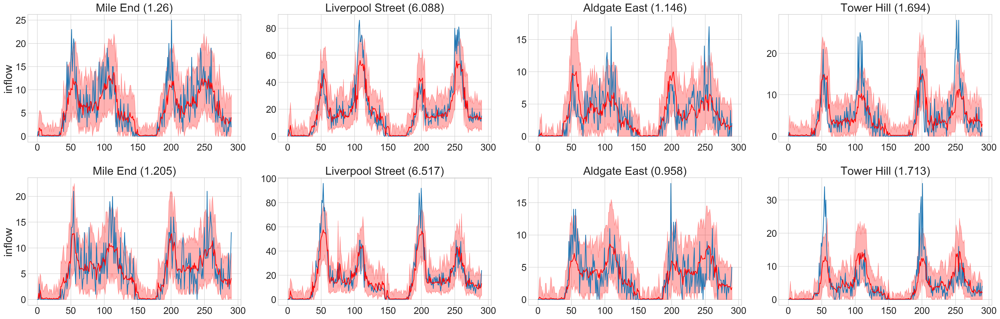

In [17]:
fig, ax = plt.subplots(num=None, figsize=(30, 10), dpi=200, facecolor='w', edgecolor='k',nrows=2, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(0, len(y_post_pred)+1, len(y_post_pred)+1)

i = 0
j = 0
color = "red"
for name in range(0, len(GFS2.factors)):
    
#     print(i, j)
    if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

    #     if i == 5:
    #         i = 0
    #         color = "Black"
        if j==0:
            
            if i < 5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)

        if i == 9:
            ax[i,j].set_xlabel('time',fontsize=24)

    #     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),

        ax[i,j].plot(time, YT_test[starting_time:290,name])

        zeros = ""
        for k in range(len(str(len(GFS2.factors)))-len(str(name))):
            zeros = zeros + "0"    

        ax[i,j].set_title(Stations["F"+zeros+str(name)]+" "+ "("+str(round(GFS2.lamb[name], 3))+")", fontsize=24)
    #     ax[i,j].xaxis.set_tick_params(labelsize=12)

        sample    = np.array(y_post_pred)[:, name, :]
        quantiles = np.quantile(sample, (0.025, 0.5, 0.975), axis = 1)
        mean = np.mean(sample, axis = 1)

        ax[i,j].plot(time[1:], mean, color=color)   
        ax[i,j].fill_between(time[1:], quantiles[0,:], quantiles[2,:], alpha = 0.3, color=color ) 
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)

        j = j+1
        
fig.tight_layout(pad=3.0)
# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Figures\london_GFSprediction.pdf', format='pdf', dpi = 200, bbox_inches='tight')

In [18]:
testPredict_list = []
RMSE_list  = []
abs_list = []
Y = (YT_test[starting_time+1:ending_time])
for i in range(0,10):
    y_post_pred_missing = GFS2.posterior_predictive_sample(pi_filt2, 100)
    Y = (YT_test[starting_time+1:ending_time])
    Y_pred = np.mean(np.array(y_post_pred_missing), axis = 2) #np.quantile(np.array(y_post_pred_missing), (0.5), axis = 2)
    
    testPredict_list.append(Y_pred)
    
    RMSE = np.sqrt(np.mean( ((Y-Y_pred)**2) ))
    abs_i = (np.mean( np.abs((Y-Y_pred)) ))
    
    RMSE_list.append(RMSE)
    abs_list.append(abs_i)

In [19]:
print("RMSE Graph Filter-Smoother posterior predictive with 4-dim state-space (1000 iterations):"
      +str(round(np.mean(RMSE_list), 3))+"+/-"+str(round(np.std(RMSE_list), 3) ))
print("ABS-metric Graph Filter-Smoother posterior predictive  with 4-dim state-space (1000 iterations):"
      +str(round(np.mean(abs_list), 3))+"+/-"+str(round(np.std(abs_list), 3) ))

RMSE Graph Filter-Smoother posterior predictive with 4-dim state-space (1000 iterations):4.798+/-0.004
ABS-metric Graph Filter-Smoother posterior predictive  with 4-dim state-space (1000 iterations):2.452+/-0.002


## Prediction on missing data

### Window with decreasing flow

Here we remove the data in a window with decreasing flows.

In [20]:
starting_time = 0
start_missing_data_time = 130
number_missing_data = 40

pi_filt_missing = np.zeros( np.array(pi_filt2).shape )
pi_filt_missing_list = [] 

pi_filt_missing[:start_missing_data_time,:,:] = np.array(pi_filt2[:start_missing_data_time])
pi_filt_missing_list = pi_filt2[:start_missing_data_time]

for time in range(start_missing_data_time, start_missing_data_time + number_missing_data):
    
    for v in range(np.array(pi_filt_missing).shape[1]):
        pi_filt_missing[time,v,:] = np.dot( pi_filt_missing[time-1][v], GFS2.transP[v] )

    pi_filt_missing_list.append(pi_filt_missing[time,:,:])

In [21]:
# size of the hidden variable
nlayers = len({n for n, d in lanepartBipartite.nodes(data=True) if d["bipartite"] == 0})

# Partition choice
trivialpart = dict()

for i in range(0,nlayers):   
    zeros = ""
    for j in range(len(str(nlayers))-len(str(i))):
        zeros = zeros + "0"
    trivialpart[str(i)] = ["V"+zeros+str(i)]

# states
states = [0, 1, 2, 3]

# m 
m = 0

mu0_initial = []
for v in range(len(top_nodes)):
    mu0_initial.append(list(pi_filt_missing[start_missing_data_time + number_missing_data-1, v, :]))


# transition kernel
transP_initial = []
for v in range(len(top_nodes)):
    transP_initial.append(parameters_variable_big["transP_list"][99][v])

# lambda
lamb_initial = []
for f in range(len(bottom_nodes)):
#     if f==17 or f==37:
#         lamb_initial.append(0.1)
#     else:
        lamb_initial.append(parameters_variable_big["lamb_list"][99][f])

# GraphFilterSmootherModule object
GFS3 = GraphFilterSmoother_C.GraphFilterSmoother_C(lanepartBipartite, states, m, trivialpart, mu0_initial, transP_initial, lamb_initial, )


In [22]:
GFS3.preprocessing()

In [23]:
import time

start = time.time()
pi_filt_after_missing = GFS3.filtering( YT_test[(start_missing_data_time + number_missing_data):ending_time,:] )
end = time.time()
print(end - start)

57.492438077926636


In [24]:
for i in range(len(pi_filt_after_missing)):
    pi_filt_missing_list.append(pi_filt_after_missing[i])

In [25]:
y_post_pred_missing = GFS3.posterior_predictive_sample_missing_data(pi_filt_missing_list, 100, start_missing_data_time, number_missing_data)

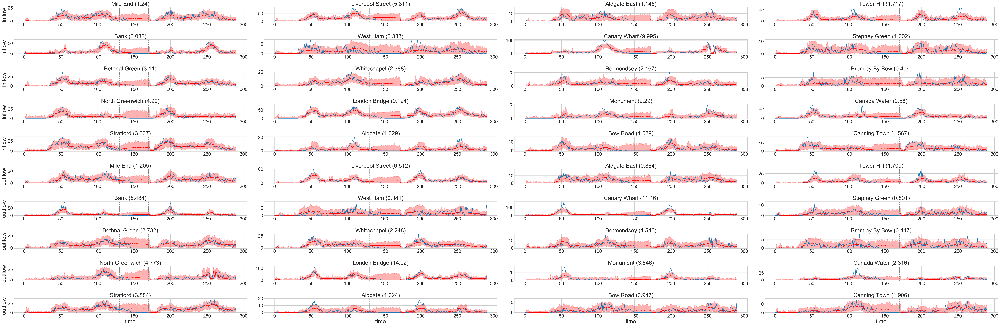

In [26]:
fig, ax = plt.subplots(num=None, figsize=(60, 20), dpi=200, facecolor='w', edgecolor='k',nrows=10, ncols=4)

time = np.linspace(0, len(y_post_pred_missing)+1, len(y_post_pred_missing)+1)

i = 0
j = 0
color = "red"
for name in range(0, len(GFS2.factors)):

#     if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i <5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)
        if i ==9:
            ax[i,j].set_xlabel('time',fontsize=24)

        ax[i,j].plot(time, YT_test[starting_time:ending_time,name])

        zeros = ""
        for k in range(len(str(len(GFS2.factors)))-len(str(name))):
            zeros = zeros + "0"    

        ax[i,j].set_title(Stations["F"+zeros+str(name)]+" "+"("+str(round(GFS3.lamb[name], 3))+")", fontsize=24)

        sample    = np.array(y_post_pred_missing)[:, name, :]
        quantiles = np.quantile(sample, (0.025, 0.5, 0.975), axis = 1)
        mean = np.mean(sample, axis = 1)

        ax[i,j].plot(time[1:], mean, color=color)   
        ax[i,j].fill_between(time[1:], quantiles[0,:], quantiles[2,:], alpha = 0.3, color=color ) 

        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)

        j = j+1
    
fig.tight_layout(pad=3.0)
# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Appendix\london_GFSpredictionmissingNopeak_complete.pdf', format='pdf', dpi = 200, bbox_inches='tight')

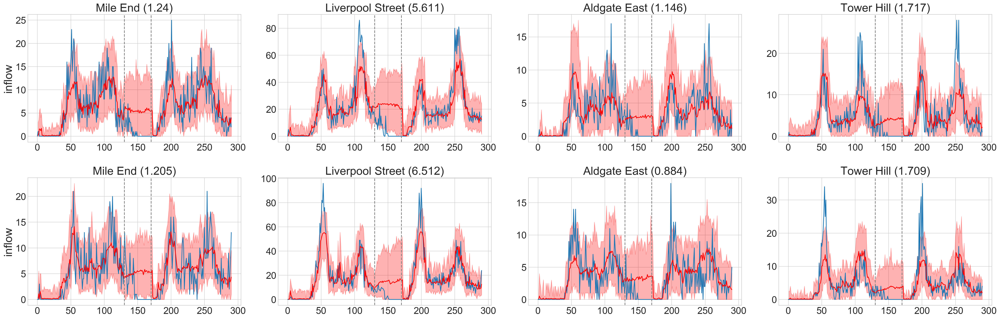

In [27]:
fig, ax = plt.subplots(num=None, figsize=(30, 10), dpi=200, facecolor='w', edgecolor='k',nrows=2, ncols=4)

time = np.linspace(0, len(y_post_pred_missing)+1, len(y_post_pred_missing)+1)

i = 0
j = 0
color = "red"
for name in range(0, len(GFS2.factors)):

    if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i <5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)
        if i ==9:
            ax[i,j].set_xlabel('time',fontsize=24)

        ax[i,j].plot(time, YT_test[starting_time:ending_time,name])

        zeros = ""
        for k in range(len(str(len(GFS2.factors)))-len(str(name))):
            zeros = zeros + "0"    

        ax[i,j].set_title(Stations["F"+zeros+str(name)]+" "+"("+str(round(GFS3.lamb[name], 3))+")", fontsize=24)

        sample    = np.array(y_post_pred_missing)[:, name, :]
        quantiles = np.quantile(sample, (0.025, 0.5, 0.975), axis = 1)
        mean = np.mean(sample, axis = 1)

        ax[i,j].plot(time[1:], mean, color=color)   
        ax[i,j].fill_between(time[1:], quantiles[0,:], quantiles[2,:], alpha = 0.3, color=color ) 

        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)

        j = j+1
    
fig.tight_layout(pad=3.0)
# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Figures\london_GFSpredictionmissingNopeak.pdf', format='pdf', dpi = 200, bbox_inches='tight')

In [28]:
testPredict_list = []
RMSE_list  = []
abs_list = []

for i in range(0,10):
    y_post_pred_missing = GFS3.posterior_predictive_sample_missing_data( pi_filt_missing_list, 100, start_missing_data_time, number_missing_data)
    Y = (YT_test[starting_time+1:ending_time])
    Y_pred = np.mean(np.array(y_post_pred_missing), axis = 2) # np.quantile(np.array(y_post_pred_missing), (0.5), axis = 2)
    
    testPredict_list.append(Y_pred)
    
    RMSE = np.sqrt(np.mean( ((Y-Y_pred)**2) ))
    abs_i = (np.mean( np.abs((Y-Y_pred)) ))
    
    RMSE_list.append(RMSE)
    abs_list.append(abs_i)

In [29]:
print("RMSE Graph Filter-Smoother posterior predictive with 4-dim state-space (1000):"
      +str(round(np.mean(RMSE_list), 3))+"+/-"+str(round(np.std(RMSE_list), 3)) )
print("ABS-metric Graph Filter-Smoother posterior predictive  with 4-dim state-space (1000):"
      +str(round(np.mean(abs_list), 3))+"+/-"+str(round(np.std(abs_list), 3)) )

RMSE Graph Filter-Smoother posterior predictive with 4-dim state-space (1000):5.404+/-0.029
ABS-metric Graph Filter-Smoother posterior predictive  with 4-dim state-space (1000):2.993+/-0.01


### Window with peak

Here we remove the data in a window with big flows.

In [30]:
starting_time = 0
start_missing_data_time = 230
number_missing_data = 40

pi_filt_missing = np.zeros( np.array(pi_filt2).shape )
pi_filt_missing_list = [] 

pi_filt_missing[:start_missing_data_time,:,:] = np.array(pi_filt2[:start_missing_data_time])
pi_filt_missing_list = pi_filt2[:start_missing_data_time]

for time in range(start_missing_data_time, start_missing_data_time + number_missing_data):
    
    for v in range(np.array(pi_filt_missing).shape[1]):
        pi_filt_missing[time,v,:] = np.dot( pi_filt_missing[time-1][v], GFS2.transP[v] )

    pi_filt_missing_list.append(pi_filt_missing[time,:,:])

In [31]:
# size of the hidden variable
nlayers = len({n for n, d in lanepartBipartite.nodes(data=True) if d["bipartite"] == 0})

# Partition choice
trivialpart = dict()

for i in range(0,nlayers):   
    zeros = ""
    for j in range(len(str(nlayers))-len(str(i))):
        zeros = zeros + "0"
    trivialpart[str(i)] = ["V"+zeros+str(i)]

# states
states = [0, 1, 2, 3]

# m 
m = 0

mu0_initial = []
for v in range(len(top_nodes)):
    mu0_initial.append(list(pi_filt_missing[start_missing_data_time + number_missing_data-1, v, :]))


# transition kernel
transP_initial = []
for v in range(len(top_nodes)):
    transP_initial.append(parameters_variable_big["transP_list"][99][v])

# lambda
lamb_initial = []
for f in range(len(bottom_nodes)):
#     if f==17 or f==37:
#         lamb_initial.append(0.1)
#     else:
        lamb_initial.append(parameters_variable_big["lamb_list"][99][f])

# GraphFilterSmootherModule object
GFS3 = GraphFilterSmoother_C.GraphFilterSmoother_C(lanepartBipartite, states, m, trivialpart, mu0_initial, transP_initial, lamb_initial, )


In [32]:
GFS3.preprocessing()

In [33]:
import time

start = time.time()
pi_filt_after_missing = GFS3.filtering( YT_test[(start_missing_data_time + number_missing_data):ending_time,:] )
end = time.time()
print(end - start)

9.047029733657837


In [34]:
for i in range(len(pi_filt_after_missing)):
    pi_filt_missing_list.append(pi_filt_after_missing[i])

In [35]:
y_post_pred_missing = GFS3.posterior_predictive_sample_missing_data(pi_filt_missing_list, 100, start_missing_data_time, number_missing_data)

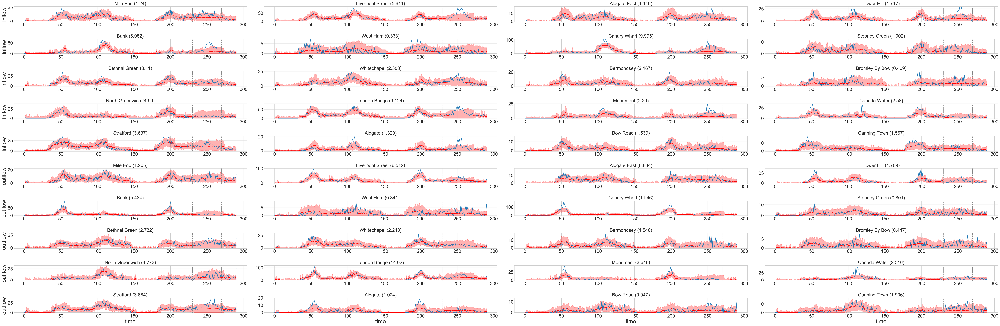

In [36]:
fig, ax = plt.subplots(num=None, figsize=(60, 20), dpi=200, facecolor='w', edgecolor='k',nrows=10, ncols=4)

time = np.linspace(0, len(y_post_pred_missing)+1, len(y_post_pred_missing)+1)

i = 0
j = 0
color = "red"
for name in range(0, len(GFS2.factors)):
    
    if j == 4:
        j = 0 
        i = i+1

    if j==0:

        if i <5:
            ax[i,j].set_ylabel('inflow',fontsize=24)
        else:
            ax[i,j].set_ylabel('outflow',fontsize=24)
    if i==9:
        ax[i,j].set_xlabel('time',fontsize=24)

    ax[i,j].plot(time, YT_test[starting_time:ending_time,name])

    zeros = ""
    for k in range(len(str(len(GFS2.factors)))-len(str(name))):
        zeros = zeros + "0"    

    ax[i,j].set_title(Stations["F"+zeros+str(name)]+" "+"("+str(round(GFS3.lamb[name], 3))+")", fontsize=20)

    sample    = np.array(y_post_pred_missing)[:, name, :]
    quantiles = np.quantile(sample, (0.025, 0.5, 0.975), axis = 1)
    mean = np.mean(sample, axis = 1)

    ax[i,j].plot(time[1:], mean, color=color)   
    ax[i,j].fill_between(time[1:], quantiles[0,:], quantiles[2,:], alpha = 0.3, color=color ) 

    ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
    ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")

    ax[i,j].tick_params(axis='x', labelsize=20) 
    ax[i,j].tick_params(axis='y', labelsize=20)

    j = j+1
    
    
fig.tight_layout(pad=3.0)
# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Appendix\london_GFSpredictionmissingpeak_complete.pdf', format='pdf', dpi = 200, bbox_inches='tight')

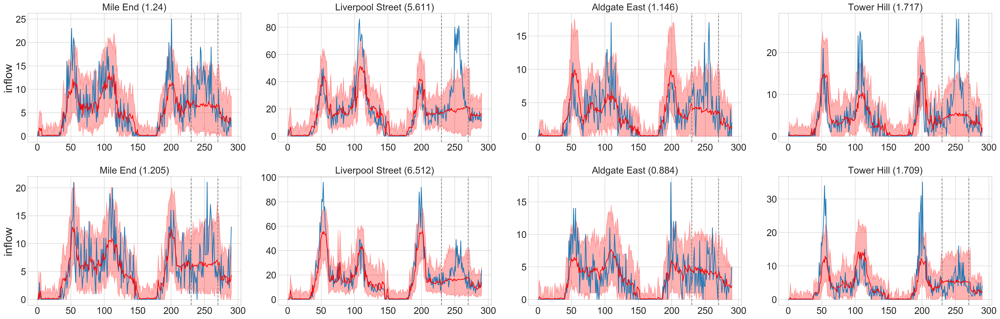

In [37]:
fig, ax = plt.subplots(num=None, figsize=(30, 10), dpi=200, facecolor='w', edgecolor='k',nrows=2, ncols=4)

time = np.linspace(0, len(y_post_pred_missing)+1, len(y_post_pred_missing)+1)

i = 0
j = 0
color = "red"
for name in range(0, len(GFS2.factors)):
 
     if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i <5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)
        if i==9:
            ax[i,j].set_xlabel('time',fontsize=24)

        ax[i,j].plot(time, YT_test[starting_time:ending_time,name])

        zeros = ""
        for k in range(len(str(len(GFS2.factors)))-len(str(name))):
            zeros = zeros + "0"    

        ax[i,j].set_title(Stations["F"+zeros+str(name)]+" "+"("+str(round(GFS3.lamb[name], 3))+")", fontsize=20)

        sample    = np.array(y_post_pred_missing)[:, name, :]
        quantiles = np.quantile(sample, (0.025, 0.5, 0.975), axis = 1)
        mean = np.mean(sample, axis = 1)

        ax[i,j].plot(time[1:], mean, color=color)   
        ax[i,j].fill_between(time[1:], quantiles[0,:], quantiles[2,:], alpha = 0.3, color=color ) 

        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)

        j = j+1
    
    
fig.tight_layout(pad=3.0)
# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Figures\london_GFSpredictionmissingpeak.pdf', format='pdf', dpi = 200, bbox_inches='tight')

In [38]:
testPredict_list = []
RMSE_list  = []
abs_list = []

for i in range(0,10):
    y_post_pred_missing = GFS3.posterior_predictive_sample_missing_data( pi_filt_missing_list, 100, start_missing_data_time, number_missing_data)
    Y = (YT_test[1:ending_time])
    Y_pred = np.mean(np.array(y_post_pred_missing), axis = 2) #np.quantile(np.array(y_post_pred_missing), (0.5), axis = 2)
    
    testPredict_list.append(Y_pred)
    
    RMSE = np.sqrt(np.mean( ((Y-Y_pred)**2) ))
    abs_i = (np.mean( np.abs((Y-Y_pred)) ))
    
    RMSE_list.append(RMSE)
    abs_list.append(abs_i)

In [39]:
print("RMSE Graph Filter-Smoother posterior predictive with 4-dim state-space (1000):"
      +str(round(np.mean(RMSE_list), 3))+"+/-"+str(round(np.std(RMSE_list), 3)) )
print("ABS-metric Graph Filter-Smoother posterior predictive  with 4-dim state-space (1000):"
      +str(round(np.mean(abs_list), 3))+"+/-"+str(round(np.std(abs_list), 3)) )

RMSE Graph Filter-Smoother posterior predictive with 4-dim state-space (1000):5.495+/-0.01
ABS-metric Graph Filter-Smoother posterior predictive  with 4-dim state-space (1000):2.65+/-0.003


## Prediction when adding/removing a lane

### 10-step-ahead prediction without changes

In [40]:
# size of the hidden variable
nlayers = len({n for n, d in lanepartBipartite.nodes(data=True) if d["bipartite"] == 0})

# Partition choice
trivialpart = dict()

for i in range(0,nlayers):   
    zeros = ""
    for j in range(len(str(nlayers))-len(str(i))):
        zeros = zeros + "0"
    trivialpart[str(i)] = ["V"+zeros+str(i)]

# states
states = [0, 1, 2, 3]

# m 
m = 0

mu0_initial = []
for v in range(len(top_nodes)):
    mu0_initial.append(parameters_variable_big["mu_0_list"][99][v])


# transition kernel
transP_initial = []
for v in range(len(top_nodes)):
    transP_initial.append(parameters_variable_big["transP_list"][99][v])

# lambda
lamb_initial = []
for f in range(len(bottom_nodes)):
#     if f==17 or f==37:
#         lamb_initial.append(0.1)
#     else:
        lamb_initial.append(parameters_variable_big["lamb_list"][99][f])

# GraphFilterSmootherModule object
GFS3 = GraphFilterSmoother_C.GraphFilterSmoother_C(lanepartBipartite, states, m, trivialpart, mu0_initial, transP_initial, lamb_initial, )


In [41]:
GFS3.preprocessing()

In [42]:
starting_time = 0
start_missing_data_time = 200
number_missing_data = 20

pi_filt_missing = np.zeros( np.array(pi_filt2).shape )
pi_filt_missing_list = [] 

pi_filt_missing[:start_missing_data_time,:,:] = np.array(pi_filt2[:start_missing_data_time])
pi_filt_missing_list = pi_filt2[:start_missing_data_time]

for time in range(start_missing_data_time, start_missing_data_time + number_missing_data):
    
    for v in range(np.array(pi_filt_missing).shape[1]):
        pi_filt_missing[time,v,:] = np.dot( pi_filt_missing[time-1][v], GFS3.transP[v] )

    pi_filt_missing_list.append(pi_filt_missing[time,:,:])

In [43]:
y_post_pred_missing = GFS3.posterior_predictive_sample_missing_data(pi_filt_missing_list, 100, start_missing_data_time, number_missing_data)

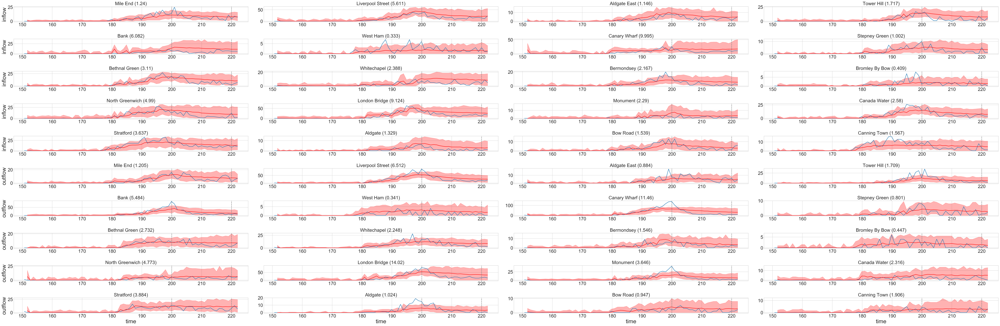

In [44]:
fig, ax = plt.subplots(num=None, figsize=(60, 20), dpi=200, facecolor='w', edgecolor='k',nrows=10, ncols=4)

time = np.linspace(0, len(y_post_pred_missing)+1, len(y_post_pred_missing)+1)

zoom = 150

i = 0
j = 0
color = "red"
for name in range(0, len(GFS2.factors)):

#     if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i <5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)

        if i ==9:
            ax[i,j].set_xlabel('time',fontsize=24)

        ax[i,j].plot(time[zoom:], YT_test[zoom:start_missing_data_time+number_missing_data+2,name])

        zeros = ""
        for k in range(len(str(len(GFS2.factors)))-len(str(name))):
            zeros = zeros + "0"    

        ax[i,j].set_title(Stations["F"+zeros+str(name)]+" "+"("+str(round(GFS3.lamb[name], 3))+")", fontsize=20)

        sample    = np.array(y_post_pred_missing)[:, name, :]
        quantiles = np.quantile(sample, (0.025, 0.5, 0.975), axis = 1)
        mean = np.mean(sample, axis = 1)

        ax[i,j].plot(time[zoom+1:], mean[zoom:], color=color)   
        ax[i,j].fill_between(time[zoom+1:], quantiles[0,zoom:], quantiles[2,zoom:], alpha = 0.3, color=color ) 

        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)

        j = j+1
    
fig.tight_layout(pad=3.0)
# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Appendix\london_GFSpredictionnext_complete.pdf', format='pdf', dpi = 200, bbox_inches='tight')

### Adding a lane

In [45]:
lanepartBipartite_new_lane = nx.read_gpickle("Data/BipartiteLondon.gpickle")

In [46]:
lanepartBipartite_new_lane.add_nodes_from(["V48"], bipartite = 0)
lanepartBipartite_new_lane.add_edges_from([(F["North Greenwich"+"-Inflow"],"V48")])
lanepartBipartite_new_lane.add_edges_from([(F["Mile End"+"-Outflow"],"V48")])

lanepartBipartite_new_lane.add_nodes_from(["V49"], bipartite = 0)
lanepartBipartite_new_lane.add_edges_from([(F["North Greenwich"+"-Outflow"],"V49")])
lanepartBipartite_new_lane.add_edges_from([(F["Mile End"+"-Inflow"],"V49")])


In [47]:
# size of the hidden variable
nlayers = len({n for n, d in lanepartBipartite_new_lane.nodes(data=True) if d["bipartite"] == 0})

# Partition choice
trivialpart = dict()

for i in range(0,nlayers):   
    zeros = ""
    for j in range(len(str(nlayers))-len(str(i))):
        zeros = zeros + "0"
    trivialpart[str(i)] = ["V"+zeros+str(i)]

# states
states = [0, 1, 2, 3]

# m 
m = 0

mu0_initial = []
for v in range(nlayers):
    if v<48:
        mu0_initial.append(pi_filt2[start_missing_data_time-1][v])
    else:
        mu0_initial.append([0, 0, 0, 1])


# transition kernel
transP_initial = []
for v in range(nlayers):
    if v<48:
        transP_initial.append(parameters_variable_big["transP_list"][99][v])
    else:
        transP_initial.append(np.mean(np.array(parameters_variable_big["transP_list"][99]), axis = 0))
        

# lambda
lamb_initial = []
for f in range(len(bottom_nodes)):
#     if f==17 or f==37:
#         lamb_initial.append(0.1)
#     else:
        lamb_initial.append(parameters_variable_big["lamb_list"][99][f])

# GraphFilterSmootherModule object
GFS_new = GraphFilterSmoother_C.GraphFilterSmoother_C(lanepartBipartite_new_lane, states, m, trivialpart, mu0_initial, transP_initial, lamb_initial, )


In [48]:
starting_time = 0
start_missing_data_time = 200
number_missing_data = 20

pi_filt_missing_list = [] 

pi_filt_missing_list = pi_filt2[:start_missing_data_time]


pi_filt_missing_list_new_lane = []
pi_filt_missing_list_new_lane.append(GFS_new.mu_0)

for time in range(1, number_missing_data+1):
    
    pi_filt = np.zeros((np.array(pi_filt2).shape[1]+2, np.array(pi_filt2).shape[2]))
    for v in range(np.array(pi_filt2).shape[1]+2):
        pi_filt[v,:] = np.dot( pi_filt_missing_list_new_lane[time-1][v], GFS_new.transP[v] )

    pi_filt_missing_list_new_lane.append(pi_filt)

In [49]:
y_post_pred_missing_old = GFS3.posterior_predictive_sample(pi_filt_missing_list, 100)

In [50]:
GFS_new.preprocessing()

In [51]:
y_post_pred_missing_new = GFS_new.posterior_predictive_sample_missing_data(pi_filt_missing_list_new_lane, 100, 1, number_missing_data)

In [52]:
y_post_pred_missing_total = np.zeros((221, 40, 100))

y_post_pred_missing_total[:199, :, :] = np.array(y_post_pred_missing_old)
y_post_pred_missing_total[199:, :, :] = np.array(y_post_pred_missing_new)

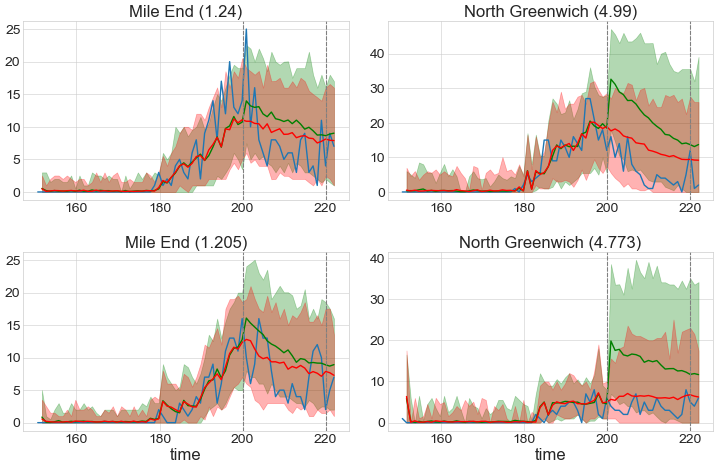

In [53]:
fig, ax = plt.subplots(num=None, figsize=(15, 10), dpi=50, facecolor='w', edgecolor='k',nrows=2, ncols=2)

time = np.linspace(0, len(y_post_pred_missing_total)+1, len(y_post_pred_missing_total)+1)

zoom = 150

i = 0
j = 0
color = "green"
for name in range(0, len(GFS2.factors)):
#     print(i,j)
    zeros = ""
    for k in range(len(str(len(GFS2.factors)))-len(str(name))):
        zeros = zeros + "0"    
        
    if Stations["F"+zeros+str(name)]=="North Greenwich" or Stations["F"+zeros+str(name)] == "Mile End":
#         print(Stations["F"+zeros+str(name)])
#         if j==0:
            
#             if i == 0:
#                 ax[i,j].set_ylabel('inflow',fontsize=24)
#             if i==1:
#                 ax[i,j].set_ylabel('outflow',fontsize=24)
        if i==1:
            ax[i,j].set_xlabel('time',fontsize=24)

        ax[i,j].plot(time[zoom:], YT_test[zoom:start_missing_data_time+number_missing_data+2,name], linewidth = 2)
        
        ax[i,j].set_title(Stations["F"+zeros+str(name)]+" "+"("+str(round(GFS3.lamb[name], 3))+")", fontsize=24)

        sample    = np.array(y_post_pred_missing_total)[:, name, :]
        quantiles = np.quantile(sample, (0.025, 0.5, 0.975), axis = 1)
        
        mean    = np.mean(sample, axis =1)

        ax[i,j].plot(time[zoom+1:], mean[zoom:], color=color, linewidth = 2)   
        ax[i,j].fill_between(time[zoom+1:], quantiles[0,zoom:], quantiles[2,zoom:], alpha = 0.3, color=color ) 

        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")

        sample    = np.array(y_post_pred_missing)[:, name, :]
        quantiles = np.quantile(sample, (0.025, 0.5, 0.975), axis = 1)
        
        mean    = np.mean(sample, axis =1)

        ax[i,j].plot(time[zoom+1:], mean[zoom:], color="red", linewidth = 2)   
        ax[i,j].fill_between(time[zoom+1:], quantiles[0,zoom:], quantiles[2,zoom:], alpha = 0.3, color="red" ) 

        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)
        
        if j == 1:
            j = 0 
            i = i+1
        else:
            j = j+1

fig.tight_layout(pad=3.0)
# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Figures\london_GFSnewlane.pdf', format='pdf', dpi = 50, bbox_inches='tight')

### Removing a lane

In [54]:
lanepartBipartite_new_lane = nx.read_gpickle("Data/BipartiteLondon.gpickle")

In [55]:
# size of the hidden variable
nlayers = len({n for n, d in lanepartBipartite_new_lane.nodes(data=True) if d["bipartite"] == 0})

# Partition choice
trivialpart = dict()

for i in range(0,nlayers):   
    zeros = ""
    for j in range(len(str(nlayers))-len(str(i))):
        zeros = zeros + "0"
    trivialpart[str(i)] = ["V"+zeros+str(i)]

# states
states = [0, 1, 2, 3]

# m 
m = 0

mu0_initial = []
for v in range(nlayers):
    if v<48:
        mu0_initial.append(pi_filt2[start_missing_data_time-1][v])
    else:
        mu0_initial.append([0, 0, 0, 1])


# transition kernel
transP_initial = []
for v in range(nlayers):
    if v<48:
        transP_initial.append(parameters_variable_big["transP_list"][99][v])
    else:
        transP_initial.append(np.mean(np.array(parameters_variable_big["transP_list"][99]), axis = 0))
        

# lambda
lamb_initial = []
for f in range(len(bottom_nodes)):
#     if f==17 or f==37:
#         lamb_initial.append(0.1)
#     else:
        lamb_initial.append(parameters_variable_big["lamb_list"][99][f])

# GraphFilterSmootherModule object
GFS_new = GraphFilterSmoother_C.GraphFilterSmoother_C(lanepartBipartite_new_lane, states, m, trivialpart, mu0_initial, transP_initial, lamb_initial, )


remove bank and London bridge (before remove Canada water and Canary wharf)

In [56]:
list_edges = []

for e in GFS_new.factor_graph.edges:
    
#     if e[1]=='V17' or e[1]=='V41' or e[0]=='V17' or e[0]=='V41':
    if e[1]=='V36' or e[1]=='V12' or e[0]=='V12' or e[0]=='V36':
        print(e)
        list_edges.append(e)
        
for e in list_edges:
        GFS_new.factor_graph.remove_edge(e[0], e[1])
        
GFS_new.shortest_path_length = dict(nx.all_pairs_shortest_path_length(GFS_new.factor_graph, 2*GFS_new.m+2))

('F24', 'V36')
('V12', 'F04')
('V12', 'F33')
('V36', 'F13')


In [57]:
GFS_new.preprocessing()

In [58]:
starting_time = 0
start_missing_data_time = 200
number_missing_data = 20

pi_filt_missing_list = [] 

pi_filt_missing_list = pi_filt2[:start_missing_data_time]


pi_filt_missing_list_new_lane = []
pi_filt_missing_list_new_lane.append(GFS_new.mu_0)

for time in range(1, number_missing_data+1):
    
    pi_filt = np.zeros((np.array(pi_filt2).shape[1], np.array(pi_filt2).shape[2]))
    for v in range(np.array(pi_filt2).shape[1]):
        pi_filt[v,:] = np.dot( pi_filt_missing_list_new_lane[time-1][v], GFS_new.transP[v] )

    pi_filt_missing_list_new_lane.append(pi_filt)

In [59]:
y_post_pred_missing_old = GFS3.posterior_predictive_sample(pi_filt_missing_list, 100)

In [60]:
y_post_pred_missing_new = GFS_new.posterior_predictive_sample_missing_data(pi_filt_missing_list_new_lane, 100, 1, number_missing_data)

In [61]:
y_post_pred_missing_total = np.zeros((221, 40, 100))

y_post_pred_missing_total[:199, :, :] = np.array(y_post_pred_missing_old)
y_post_pred_missing_total[199:, :, :] = np.array(y_post_pred_missing_new)

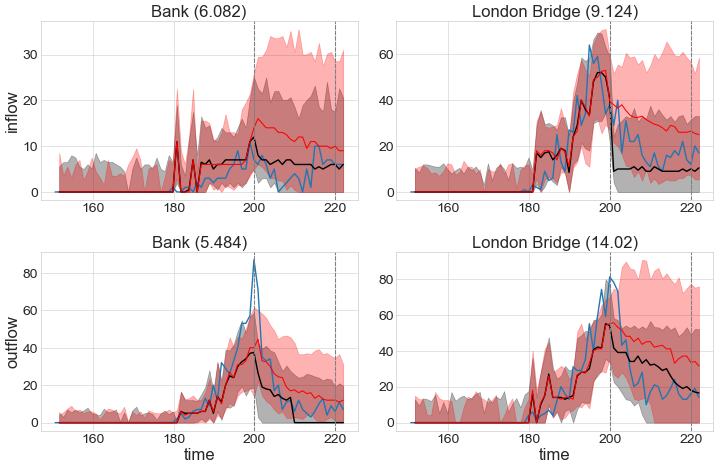

In [62]:
fig, ax = plt.subplots(num=None, figsize=(15, 10), dpi=50, facecolor='w', edgecolor='k',nrows=2, ncols=2)

time = np.linspace(0, len(y_post_pred_missing_total)+1, len(y_post_pred_missing_total)+1)

zoom = 150

i = 0
j = 0
color = "black"
for name in range(0, len(GFS2.factors)):
    
    zeros = ""
    for k in range(len(str(len(GFS2.factors)))-len(str(name))):
        zeros = zeros + "0"    

    if Stations["F"+zeros+str(name)]=="Bank" or Stations["F"+zeros+str(name)] =="London Bridge":

        if j==0:
            
            if i == 0:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            if i==1:
                ax[i,j].set_ylabel('outflow',fontsize=24)
        if i==1:
            ax[i,j].set_xlabel('time',fontsize=24)

        ax[i,j].plot(time[zoom:], YT_test[zoom:start_missing_data_time+number_missing_data+2,name], linewidth = 2)                                            
                                             
        ax[i,j].set_title(Stations["F"+zeros+str(name)]+" "+"("+str(round(GFS3.lamb[name], 3))+")", fontsize=24)

        sample    = np.array(y_post_pred_missing_total)[:, name, :]
        quantiles = np.quantile(sample, (0.025, 0.5, 0.975), axis = 1)
        
        mean = np.mean(sample, axis =1)

        ax[i,j].plot(time[zoom+1:], quantiles[1,zoom:], color=color, linewidth = 2)   
        ax[i,j].fill_between(time[zoom+1:], quantiles[0,zoom:], quantiles[2,zoom:], alpha = 0.3, color=color ) 

        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")

        sample    = np.array(y_post_pred_missing)[:, name, :]
        quantiles = np.quantile(sample, (0.025, 0.5, 0.975), axis = 1)
        
        mean = np.mean(sample, axis =1)

        ax[i,j].plot(time[zoom+1:], quantiles[1,zoom:], color="red")   
        ax[i,j].fill_between(time[zoom+1:], quantiles[0,zoom:], quantiles[2,zoom:], alpha = 0.3, color="red" ) 

        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)
        
        if j==1:
            j=0
            i=i+1
        else:
            j = j+1
    
fig.tight_layout(pad=3.0)
# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Figures\london_GFSremovelane.pdf', format='pdf', dpi = 50, bbox_inches='tight')